In [1]:
from __future__ import print_function, division
import os
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

plt.ion()   # interactive mode

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import sys
sys.path.insert(0, '../')

In [4]:
os.environ['CUDA_VISIBLE_DEVICES'] = '0,1'

# Training using the ResNet topology

In [5]:
from cpe775.networks.resnet import resnet34

In [6]:
net = resnet34(in_shape=(-1, 1, 256, 256), out_shape=(-1, 68, 2))

## Loading the dataset and splitting between train and valid

In [7]:
from cpe775.dataset import FaceLandmarksDataset, CroppedFaceLandmarksDataset
from torch.utils.data.sampler import SubsetRandomSampler
from torchvision.transforms import Compose
from cpe775.transforms import ToTensor, CropFace, ToGray, RandomHorizontalFlip, ToPILImage, RandomCrop, CenterCrop

In [8]:
batch_size = 128
random_seed = 42
valid_size = 0.2
shuffle = True

In [9]:
train_transforms = Compose([
                   ToPILImage(),
                   RandomCrop((224,224)),
                   RandomHorizontalFlip(),
                   ToGray(),
                   ToTensor()
                 ])

transforms = Compose([
                   ToPILImage(),
                   CenterCrop((224,224)),
                   ToGray(),
                   ToTensor()
                 ])

In [10]:
# load the dataset
train_dataset = CroppedFaceLandmarksDataset(data_file='../data/train.npz',
                                            transform=train_transforms)
valid_dataset = CroppedFaceLandmarksDataset(data_file='../data/train.npz',
                                            transform=transforms)

num_train = len(train_dataset)
indices = list(range(num_train))
split = int(np.floor(valid_size * num_train))

if shuffle == True:
    np.random.seed(random_seed)
    np.random.shuffle(indices)

train_idx, valid_idx = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_idx)
valid_sampler = SubsetRandomSampler(valid_idx)

train_loader = torch.utils.data.DataLoader(train_dataset, 
                batch_size=batch_size, sampler=train_sampler, num_workers=4)

valid_loader = torch.utils.data.DataLoader(valid_dataset, 
                batch_size=batch_size, sampler=valid_sampler, num_workers=4)

## Creating the model

In [11]:
net = torch.nn.DataParallel(net)
net = net.cuda()

In [12]:
np.sum([v.numel() for v in net.parameters()])

2237496

## Creating the loss function

In [13]:
import torch
from cpe775.criterion import NRMSELoss
from cpe775.model import Model
from cpe775 import callbacks

In [14]:
criterion = NRMSELoss(weight=224)
criterion = criterion.cuda()

In [15]:
optimizer = torch.optim.SGD(net.parameters(), 0.001, momentum=0.9)
model = Model(net, criterion=criterion)
model.set_optimizer(optimizer)

## Training

In [16]:
from torch.optim.lr_scheduler import MultiStepLR
from cpe775 import metrics

In [17]:
callback_list = [
        callbacks.Progbar(print_freq=40),
        callbacks.ModelCheckpoint('../results/resnet/resnet-34-1c.pth.tar', 'val_loss', mode='min'),
        callbacks.LearningRateScheduler(MultiStepLR(optimizer, milestones=[500,750], gamma=0.1))
    ]

In [18]:
model.fit_loader(train_loader, 1000, val_loader=valid_loader,
                 callback=callbacks.Compose(callback_list), metrics={'nrmse': NRMSELoss(norm='outer_eyes_distance')})

Epoch: [0][0/20]	Time 3.112 (3.112)	Data 0.176 (0.176)	Train Loss 1087.325 (1087.325)	Train Nrmse 3.488 (3.488)	
Val: [0/5]	Time 0.239 (0.239)	Data 0.194 (0.194)	Val Loss 1162009.500 (1162009.500)	Val Nrmse 3729.300 (3729.300)	
Epoch: [1][0/20]	Time 0.315 (0.315)	Data 0.257 (0.257)	Train Loss 114.873 (114.873)	Train Nrmse 0.367 (0.367)	
Val: [0/5]	Time 0.246 (0.246)	Data 0.214 (0.214)	Val Loss 379.346 (379.346)	Val Nrmse 1.214 (1.214)	
Epoch: [2][0/20]	Time 0.257 (0.257)	Data 0.184 (0.184)	Train Loss 103.843 (103.843)	Train Nrmse 0.332 (0.332)	
Val: [0/5]	Time 0.207 (0.207)	Data 0.172 (0.172)	Val Loss 74.447 (74.447)	Val Nrmse 0.240 (0.240)	
Epoch: [3][0/20]	Time 0.304 (0.304)	Data 0.243 (0.243)	Train Loss 84.474 (84.474)	Train Nrmse 0.270 (0.270)	
Val: [0/5]	Time 0.245 (0.245)	Data 0.208 (0.208)	Val Loss 56.110 (56.110)	Val Nrmse 0.180 (0.180)	
Epoch: [4][0/20]	Time 0.344 (0.344)	Data 0.276 (0.276)	Train Loss 73.241 (73.241)	Train Nrmse 0.234 (0.234)	
Val: [0/5]	Time 0.293 (0.293)	Dat

Val: [0/5]	Time 0.258 (0.258)	Data 0.227 (0.227)	Val Loss 54.302 (54.302)	Val Nrmse 0.173 (0.173)	
Epoch: [40][0/20]	Time 0.264 (0.264)	Data 0.198 (0.198)	Train Loss 69.464 (69.464)	Train Nrmse 0.223 (0.223)	
Val: [0/5]	Time 0.262 (0.262)	Data 0.232 (0.232)	Val Loss 53.978 (53.978)	Val Nrmse 0.173 (0.173)	
Epoch: [41][0/20]	Time 0.301 (0.301)	Data 0.227 (0.227)	Train Loss 67.038 (67.038)	Train Nrmse 0.215 (0.215)	
Val: [0/5]	Time 0.205 (0.205)	Data 0.174 (0.174)	Val Loss 53.148 (53.148)	Val Nrmse 0.171 (0.171)	
Epoch: [42][0/20]	Time 0.271 (0.271)	Data 0.210 (0.210)	Train Loss 74.613 (74.613)	Train Nrmse 0.239 (0.239)	
Val: [0/5]	Time 0.246 (0.246)	Data 0.216 (0.216)	Val Loss 53.848 (53.848)	Val Nrmse 0.173 (0.173)	
Epoch: [43][0/20]	Time 0.244 (0.244)	Data 0.182 (0.182)	Train Loss 71.697 (71.697)	Train Nrmse 0.229 (0.229)	
Val: [0/5]	Time 0.212 (0.212)	Data 0.182 (0.182)	Val Loss 57.346 (57.346)	Val Nrmse 0.185 (0.185)	
Epoch: [44][0/20]	Time 0.238 (0.238)	Data 0.182 (0.182)	Train Los

Epoch: [79][0/20]	Time 0.308 (0.308)	Data 0.226 (0.226)	Train Loss 35.142 (35.142)	Train Nrmse 0.113 (0.113)	
Val: [0/5]	Time 0.241 (0.241)	Data 0.201 (0.201)	Val Loss 27.555 (27.555)	Val Nrmse 0.088 (0.088)	
Epoch: [80][0/20]	Time 0.299 (0.299)	Data 0.227 (0.227)	Train Loss 30.632 (30.632)	Train Nrmse 0.098 (0.098)	
Val: [0/5]	Time 0.247 (0.247)	Data 0.213 (0.213)	Val Loss 24.855 (24.855)	Val Nrmse 0.080 (0.080)	
Epoch: [81][0/20]	Time 0.288 (0.288)	Data 0.207 (0.207)	Train Loss 29.636 (29.636)	Train Nrmse 0.095 (0.095)	
Val: [0/5]	Time 0.226 (0.226)	Data 0.187 (0.187)	Val Loss 26.397 (26.397)	Val Nrmse 0.085 (0.085)	
Epoch: [82][0/20]	Time 0.272 (0.272)	Data 0.189 (0.189)	Train Loss 27.142 (27.142)	Train Nrmse 0.087 (0.087)	
Val: [0/5]	Time 0.254 (0.254)	Data 0.225 (0.225)	Val Loss 29.115 (29.115)	Val Nrmse 0.093 (0.093)	
Epoch: [83][0/20]	Time 0.328 (0.328)	Data 0.260 (0.260)	Train Loss 28.324 (28.324)	Train Nrmse 0.091 (0.091)	
Val: [0/5]	Time 0.227 (0.227)	Data 0.190 (0.190)	Val L

Val: [0/5]	Time 0.241 (0.241)	Data 0.210 (0.210)	Val Loss 18.580 (18.580)	Val Nrmse 0.060 (0.060)	
Epoch: [119][0/20]	Time 0.298 (0.298)	Data 0.236 (0.236)	Train Loss 20.321 (20.321)	Train Nrmse 0.065 (0.065)	
Val: [0/5]	Time 0.259 (0.259)	Data 0.221 (0.221)	Val Loss 20.269 (20.269)	Val Nrmse 0.065 (0.065)	
Epoch: [120][0/20]	Time 0.258 (0.258)	Data 0.180 (0.180)	Train Loss 20.143 (20.143)	Train Nrmse 0.065 (0.065)	
Val: [0/5]	Time 0.201 (0.201)	Data 0.171 (0.171)	Val Loss 24.752 (24.752)	Val Nrmse 0.079 (0.079)	
Epoch: [121][0/20]	Time 0.247 (0.247)	Data 0.181 (0.181)	Train Loss 21.511 (21.511)	Train Nrmse 0.069 (0.069)	
Val: [0/5]	Time 0.245 (0.245)	Data 0.208 (0.208)	Val Loss 22.099 (22.099)	Val Nrmse 0.071 (0.071)	
Epoch: [122][0/20]	Time 0.288 (0.288)	Data 0.214 (0.214)	Train Loss 21.218 (21.218)	Train Nrmse 0.068 (0.068)	
Val: [0/5]	Time 0.219 (0.219)	Data 0.188 (0.188)	Val Loss 24.834 (24.834)	Val Nrmse 0.080 (0.080)	
Epoch: [123][0/20]	Time 0.247 (0.247)	Data 0.191 (0.191)	Trai

Epoch: [158][0/20]	Time 0.280 (0.280)	Data 0.201 (0.201)	Train Loss 20.189 (20.189)	Train Nrmse 0.065 (0.065)	
Val: [0/5]	Time 0.259 (0.259)	Data 0.229 (0.229)	Val Loss 23.563 (23.563)	Val Nrmse 0.076 (0.076)	
Epoch: [159][0/20]	Time 0.282 (0.282)	Data 0.203 (0.203)	Train Loss 20.661 (20.661)	Train Nrmse 0.066 (0.066)	
Val: [0/5]	Time 0.240 (0.240)	Data 0.202 (0.202)	Val Loss 20.292 (20.292)	Val Nrmse 0.065 (0.065)	
Epoch: [160][0/20]	Time 0.311 (0.311)	Data 0.252 (0.252)	Train Loss 20.512 (20.512)	Train Nrmse 0.066 (0.066)	
Val: [0/5]	Time 0.236 (0.236)	Data 0.206 (0.206)	Val Loss 23.486 (23.486)	Val Nrmse 0.076 (0.076)	
Epoch: [161][0/20]	Time 0.280 (0.280)	Data 0.201 (0.201)	Train Loss 19.070 (19.070)	Train Nrmse 0.061 (0.061)	
Val: [0/5]	Time 0.251 (0.251)	Data 0.220 (0.220)	Val Loss 17.062 (17.062)	Val Nrmse 0.055 (0.055)	
Epoch: [162][0/20]	Time 0.286 (0.286)	Data 0.222 (0.222)	Train Loss 17.338 (17.338)	Train Nrmse 0.056 (0.056)	
Val: [0/5]	Time 0.222 (0.222)	Data 0.183 (0.183)	

Val: [0/5]	Time 0.211 (0.211)	Data 0.176 (0.176)	Val Loss 18.837 (18.837)	Val Nrmse 0.060 (0.060)	
Epoch: [198][0/20]	Time 0.297 (0.297)	Data 0.217 (0.217)	Train Loss 16.353 (16.353)	Train Nrmse 0.052 (0.052)	
Val: [0/5]	Time 0.247 (0.247)	Data 0.215 (0.215)	Val Loss 18.053 (18.053)	Val Nrmse 0.058 (0.058)	
Epoch: [199][0/20]	Time 0.265 (0.265)	Data 0.204 (0.204)	Train Loss 16.976 (16.976)	Train Nrmse 0.055 (0.055)	
Val: [0/5]	Time 0.237 (0.237)	Data 0.205 (0.205)	Val Loss 16.168 (16.168)	Val Nrmse 0.052 (0.052)	
Epoch: [200][0/20]	Time 0.337 (0.337)	Data 0.257 (0.257)	Train Loss 15.201 (15.201)	Train Nrmse 0.049 (0.049)	
Val: [0/5]	Time 0.234 (0.234)	Data 0.203 (0.203)	Val Loss 17.062 (17.062)	Val Nrmse 0.055 (0.055)	
Epoch: [201][0/20]	Time 0.258 (0.258)	Data 0.181 (0.181)	Train Loss 15.734 (15.734)	Train Nrmse 0.050 (0.050)	
Val: [0/5]	Time 0.251 (0.251)	Data 0.207 (0.207)	Val Loss 17.503 (17.503)	Val Nrmse 0.056 (0.056)	
Epoch: [202][0/20]	Time 0.292 (0.292)	Data 0.218 (0.218)	Trai

Epoch: [237][0/20]	Time 0.274 (0.274)	Data 0.195 (0.195)	Train Loss 15.154 (15.154)	Train Nrmse 0.048 (0.048)	
Val: [0/5]	Time 0.242 (0.242)	Data 0.198 (0.198)	Val Loss 15.742 (15.742)	Val Nrmse 0.050 (0.050)	
Epoch: [238][0/20]	Time 0.310 (0.310)	Data 0.244 (0.244)	Train Loss 16.227 (16.227)	Train Nrmse 0.052 (0.052)	
Val: [0/5]	Time 0.220 (0.220)	Data 0.188 (0.188)	Val Loss 16.163 (16.163)	Val Nrmse 0.052 (0.052)	
Epoch: [239][0/20]	Time 0.247 (0.247)	Data 0.183 (0.183)	Train Loss 14.676 (14.676)	Train Nrmse 0.047 (0.047)	
Val: [0/5]	Time 0.220 (0.220)	Data 0.187 (0.187)	Val Loss 16.725 (16.725)	Val Nrmse 0.054 (0.054)	
Epoch: [240][0/20]	Time 0.278 (0.278)	Data 0.217 (0.217)	Train Loss 15.458 (15.458)	Train Nrmse 0.050 (0.050)	
Val: [0/5]	Time 0.243 (0.243)	Data 0.209 (0.209)	Val Loss 16.350 (16.350)	Val Nrmse 0.053 (0.053)	
Epoch: [241][0/20]	Time 0.270 (0.270)	Data 0.202 (0.202)	Train Loss 15.609 (15.609)	Train Nrmse 0.050 (0.050)	
Val: [0/5]	Time 0.210 (0.210)	Data 0.174 (0.174)	

Val: [0/5]	Time 0.210 (0.210)	Data 0.173 (0.173)	Val Loss 16.585 (16.585)	Val Nrmse 0.053 (0.053)	
Epoch: [277][0/20]	Time 0.283 (0.283)	Data 0.226 (0.226)	Train Loss 14.393 (14.393)	Train Nrmse 0.046 (0.046)	
Val: [0/5]	Time 0.212 (0.212)	Data 0.181 (0.181)	Val Loss 18.569 (18.569)	Val Nrmse 0.060 (0.060)	
Epoch: [278][0/20]	Time 0.238 (0.238)	Data 0.178 (0.178)	Train Loss 16.605 (16.605)	Train Nrmse 0.053 (0.053)	
Val: [0/5]	Time 0.218 (0.218)	Data 0.186 (0.186)	Val Loss 17.099 (17.099)	Val Nrmse 0.055 (0.055)	
Epoch: [279][0/20]	Time 0.298 (0.298)	Data 0.239 (0.239)	Train Loss 15.423 (15.423)	Train Nrmse 0.050 (0.050)	
Val: [0/5]	Time 0.229 (0.229)	Data 0.190 (0.190)	Val Loss 16.867 (16.867)	Val Nrmse 0.054 (0.054)	
Epoch: [280][0/20]	Time 0.280 (0.280)	Data 0.222 (0.222)	Train Loss 14.754 (14.754)	Train Nrmse 0.047 (0.047)	
Val: [0/5]	Time 0.239 (0.239)	Data 0.190 (0.190)	Val Loss 15.434 (15.434)	Val Nrmse 0.049 (0.049)	
Epoch: [281][0/20]	Time 0.290 (0.290)	Data 0.229 (0.229)	Trai

Epoch: [316][0/20]	Time 0.292 (0.292)	Data 0.222 (0.222)	Train Loss 14.232 (14.232)	Train Nrmse 0.046 (0.046)	
Val: [0/5]	Time 0.273 (0.273)	Data 0.234 (0.234)	Val Loss 14.529 (14.529)	Val Nrmse 0.047 (0.047)	
Epoch: [317][0/20]	Time 0.258 (0.258)	Data 0.197 (0.197)	Train Loss 14.784 (14.784)	Train Nrmse 0.047 (0.047)	
Val: [0/5]	Time 0.248 (0.248)	Data 0.211 (0.211)	Val Loss 15.326 (15.326)	Val Nrmse 0.049 (0.049)	
Epoch: [318][0/20]	Time 0.252 (0.252)	Data 0.180 (0.180)	Train Loss 13.792 (13.792)	Train Nrmse 0.044 (0.044)	
Val: [0/5]	Time 0.232 (0.232)	Data 0.186 (0.186)	Val Loss 16.775 (16.775)	Val Nrmse 0.054 (0.054)	
Epoch: [319][0/20]	Time 0.278 (0.278)	Data 0.210 (0.210)	Train Loss 15.130 (15.130)	Train Nrmse 0.049 (0.049)	
Val: [0/5]	Time 0.210 (0.210)	Data 0.179 (0.179)	Val Loss 16.223 (16.223)	Val Nrmse 0.052 (0.052)	
Epoch: [320][0/20]	Time 0.259 (0.259)	Data 0.189 (0.189)	Train Loss 14.417 (14.417)	Train Nrmse 0.046 (0.046)	
Val: [0/5]	Time 0.265 (0.265)	Data 0.218 (0.218)	

Val: [0/5]	Time 0.220 (0.220)	Data 0.187 (0.187)	Val Loss 15.743 (15.743)	Val Nrmse 0.051 (0.051)	
Epoch: [356][0/20]	Time 0.266 (0.266)	Data 0.203 (0.203)	Train Loss 13.956 (13.956)	Train Nrmse 0.045 (0.045)	
Val: [0/5]	Time 0.211 (0.211)	Data 0.175 (0.175)	Val Loss 15.534 (15.534)	Val Nrmse 0.050 (0.050)	
Epoch: [357][0/20]	Time 0.287 (0.287)	Data 0.221 (0.221)	Train Loss 14.029 (14.029)	Train Nrmse 0.045 (0.045)	
Val: [0/5]	Time 0.250 (0.250)	Data 0.208 (0.208)	Val Loss 15.119 (15.119)	Val Nrmse 0.049 (0.049)	
Epoch: [358][0/20]	Time 0.280 (0.280)	Data 0.209 (0.209)	Train Loss 12.853 (12.853)	Train Nrmse 0.041 (0.041)	
Val: [0/5]	Time 0.219 (0.219)	Data 0.189 (0.189)	Val Loss 15.781 (15.781)	Val Nrmse 0.051 (0.051)	
Epoch: [359][0/20]	Time 0.260 (0.260)	Data 0.190 (0.190)	Train Loss 13.170 (13.170)	Train Nrmse 0.042 (0.042)	
Val: [0/5]	Time 0.247 (0.247)	Data 0.216 (0.216)	Val Loss 15.529 (15.529)	Val Nrmse 0.050 (0.050)	
Epoch: [360][0/20]	Time 0.270 (0.270)	Data 0.192 (0.192)	Trai

Epoch: [395][0/20]	Time 0.271 (0.271)	Data 0.205 (0.205)	Train Loss 13.441 (13.441)	Train Nrmse 0.043 (0.043)	
Val: [0/5]	Time 0.232 (0.232)	Data 0.203 (0.203)	Val Loss 14.443 (14.443)	Val Nrmse 0.046 (0.046)	
Epoch: [396][0/20]	Time 0.294 (0.294)	Data 0.213 (0.213)	Train Loss 13.155 (13.155)	Train Nrmse 0.042 (0.042)	
Val: [0/5]	Time 0.220 (0.220)	Data 0.182 (0.182)	Val Loss 15.483 (15.483)	Val Nrmse 0.050 (0.050)	
Epoch: [397][0/20]	Time 0.306 (0.306)	Data 0.241 (0.241)	Train Loss 13.536 (13.536)	Train Nrmse 0.043 (0.043)	
Val: [0/5]	Time 0.228 (0.228)	Data 0.188 (0.188)	Val Loss 16.049 (16.049)	Val Nrmse 0.052 (0.052)	
Epoch: [398][0/20]	Time 0.261 (0.261)	Data 0.188 (0.188)	Train Loss 13.609 (13.609)	Train Nrmse 0.044 (0.044)	
Val: [0/5]	Time 0.271 (0.271)	Data 0.235 (0.235)	Val Loss 15.633 (15.633)	Val Nrmse 0.050 (0.050)	
Epoch: [399][0/20]	Time 0.283 (0.283)	Data 0.197 (0.197)	Train Loss 12.900 (12.900)	Train Nrmse 0.041 (0.041)	
Val: [0/5]	Time 0.233 (0.233)	Data 0.196 (0.196)	

Val: [0/5]	Time 0.219 (0.219)	Data 0.186 (0.186)	Val Loss 14.057 (14.057)	Val Nrmse 0.045 (0.045)	
Epoch: [435][0/20]	Time 0.262 (0.262)	Data 0.198 (0.198)	Train Loss 12.299 (12.299)	Train Nrmse 0.040 (0.040)	
Val: [0/5]	Time 0.258 (0.258)	Data 0.221 (0.221)	Val Loss 14.681 (14.681)	Val Nrmse 0.047 (0.047)	
Epoch: [436][0/20]	Time 0.263 (0.263)	Data 0.203 (0.203)	Train Loss 12.596 (12.596)	Train Nrmse 0.040 (0.040)	
Val: [0/5]	Time 0.229 (0.229)	Data 0.200 (0.200)	Val Loss 14.527 (14.527)	Val Nrmse 0.047 (0.047)	
Epoch: [437][0/20]	Time 0.286 (0.286)	Data 0.212 (0.212)	Train Loss 12.428 (12.428)	Train Nrmse 0.040 (0.040)	
Val: [0/5]	Time 0.235 (0.235)	Data 0.197 (0.197)	Val Loss 14.537 (14.537)	Val Nrmse 0.047 (0.047)	
Epoch: [438][0/20]	Time 0.276 (0.276)	Data 0.202 (0.202)	Train Loss 13.502 (13.502)	Train Nrmse 0.043 (0.043)	
Val: [0/5]	Time 0.237 (0.237)	Data 0.200 (0.200)	Val Loss 14.852 (14.852)	Val Nrmse 0.048 (0.048)	
Epoch: [439][0/20]	Time 0.281 (0.281)	Data 0.213 (0.213)	Trai

Epoch: [474][0/20]	Time 0.284 (0.284)	Data 0.207 (0.207)	Train Loss 12.708 (12.708)	Train Nrmse 0.041 (0.041)	
Val: [0/5]	Time 0.244 (0.244)	Data 0.208 (0.208)	Val Loss 16.089 (16.089)	Val Nrmse 0.052 (0.052)	
Epoch: [475][0/20]	Time 0.284 (0.284)	Data 0.210 (0.210)	Train Loss 12.855 (12.855)	Train Nrmse 0.041 (0.041)	
Val: [0/5]	Time 0.237 (0.237)	Data 0.199 (0.199)	Val Loss 14.807 (14.807)	Val Nrmse 0.048 (0.048)	
Epoch: [476][0/20]	Time 0.266 (0.266)	Data 0.196 (0.196)	Train Loss 12.723 (12.723)	Train Nrmse 0.041 (0.041)	
Val: [0/5]	Time 0.249 (0.249)	Data 0.214 (0.214)	Val Loss 13.883 (13.883)	Val Nrmse 0.044 (0.044)	
Epoch: [477][0/20]	Time 0.246 (0.246)	Data 0.178 (0.178)	Train Loss 12.435 (12.435)	Train Nrmse 0.040 (0.040)	
Val: [0/5]	Time 0.215 (0.215)	Data 0.183 (0.183)	Val Loss 13.860 (13.860)	Val Nrmse 0.045 (0.045)	
Epoch: [478][0/20]	Time 0.267 (0.267)	Data 0.204 (0.204)	Train Loss 12.348 (12.348)	Train Nrmse 0.040 (0.040)	
Val: [0/5]	Time 0.234 (0.234)	Data 0.204 (0.204)	

Val: [0/5]	Time 0.246 (0.246)	Data 0.214 (0.214)	Val Loss 14.073 (14.073)	Val Nrmse 0.045 (0.045)	
Epoch: [514][0/20]	Time 0.269 (0.269)	Data 0.203 (0.203)	Train Loss 11.274 (11.274)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.224 (0.224)	Data 0.193 (0.193)	Val Loss 13.779 (13.779)	Val Nrmse 0.044 (0.044)	
Epoch: [515][0/20]	Time 0.355 (0.355)	Data 0.292 (0.292)	Train Loss 11.327 (11.327)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.229 (0.229)	Data 0.191 (0.191)	Val Loss 13.578 (13.578)	Val Nrmse 0.044 (0.044)	
Epoch: [516][0/20]	Time 0.340 (0.340)	Data 0.278 (0.278)	Train Loss 11.587 (11.587)	Train Nrmse 0.037 (0.037)	
Val: [0/5]	Time 0.237 (0.237)	Data 0.206 (0.206)	Val Loss 13.476 (13.476)	Val Nrmse 0.043 (0.043)	
Epoch: [517][0/20]	Time 0.261 (0.261)	Data 0.191 (0.191)	Train Loss 11.600 (11.600)	Train Nrmse 0.037 (0.037)	
Val: [0/5]	Time 0.230 (0.230)	Data 0.198 (0.198)	Val Loss 13.886 (13.886)	Val Nrmse 0.045 (0.045)	
Epoch: [518][0/20]	Time 0.277 (0.277)	Data 0.204 (0.204)	Trai

Epoch: [553][0/20]	Time 0.303 (0.303)	Data 0.231 (0.231)	Train Loss 11.342 (11.342)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.236 (0.236)	Data 0.206 (0.206)	Val Loss 13.358 (13.358)	Val Nrmse 0.043 (0.043)	
Epoch: [554][0/20]	Time 0.279 (0.279)	Data 0.222 (0.222)	Train Loss 11.744 (11.744)	Train Nrmse 0.038 (0.038)	
Val: [0/5]	Time 0.242 (0.242)	Data 0.212 (0.212)	Val Loss 13.446 (13.446)	Val Nrmse 0.043 (0.043)	
Epoch: [555][0/20]	Time 0.264 (0.264)	Data 0.191 (0.191)	Train Loss 11.692 (11.692)	Train Nrmse 0.037 (0.037)	
Val: [0/5]	Time 0.208 (0.208)	Data 0.176 (0.176)	Val Loss 14.305 (14.305)	Val Nrmse 0.046 (0.046)	
Epoch: [556][0/20]	Time 0.272 (0.272)	Data 0.210 (0.210)	Train Loss 11.073 (11.073)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.226 (0.226)	Data 0.187 (0.187)	Val Loss 13.397 (13.397)	Val Nrmse 0.043 (0.043)	
Epoch: [557][0/20]	Time 0.244 (0.244)	Data 0.189 (0.189)	Train Loss 11.879 (11.879)	Train Nrmse 0.038 (0.038)	
Val: [0/5]	Time 0.267 (0.267)	Data 0.237 (0.237)	

Val: [0/5]	Time 0.240 (0.240)	Data 0.203 (0.203)	Val Loss 13.513 (13.513)	Val Nrmse 0.043 (0.043)	
Epoch: [593][0/20]	Time 0.351 (0.351)	Data 0.230 (0.230)	Train Loss 11.375 (11.375)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.215 (0.215)	Data 0.184 (0.184)	Val Loss 13.930 (13.930)	Val Nrmse 0.045 (0.045)	
Epoch: [594][0/20]	Time 0.359 (0.359)	Data 0.293 (0.293)	Train Loss 11.065 (11.065)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.204 (0.204)	Data 0.173 (0.173)	Val Loss 13.650 (13.650)	Val Nrmse 0.044 (0.044)	
Epoch: [595][0/20]	Time 0.250 (0.250)	Data 0.182 (0.182)	Train Loss 11.439 (11.439)	Train Nrmse 0.037 (0.037)	
Val: [0/5]	Time 0.220 (0.220)	Data 0.184 (0.184)	Val Loss 12.736 (12.736)	Val Nrmse 0.041 (0.041)	
Epoch: [596][0/20]	Time 0.366 (0.366)	Data 0.252 (0.252)	Train Loss 11.351 (11.351)	Train Nrmse 0.037 (0.037)	
Val: [0/5]	Time 0.224 (0.224)	Data 0.182 (0.182)	Val Loss 13.613 (13.613)	Val Nrmse 0.044 (0.044)	
Epoch: [597][0/20]	Time 0.288 (0.288)	Data 0.216 (0.216)	Trai

Epoch: [632][0/20]	Time 0.294 (0.294)	Data 0.218 (0.218)	Train Loss 11.400 (11.400)	Train Nrmse 0.037 (0.037)	
Val: [0/5]	Time 0.211 (0.211)	Data 0.177 (0.177)	Val Loss 13.992 (13.992)	Val Nrmse 0.045 (0.045)	
Epoch: [633][0/20]	Time 0.256 (0.256)	Data 0.196 (0.196)	Train Loss 11.660 (11.660)	Train Nrmse 0.038 (0.038)	
Val: [0/5]	Time 0.248 (0.248)	Data 0.218 (0.218)	Val Loss 13.889 (13.889)	Val Nrmse 0.044 (0.044)	
Epoch: [634][0/20]	Time 0.317 (0.317)	Data 0.190 (0.190)	Train Loss 11.231 (11.231)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.215 (0.215)	Data 0.185 (0.185)	Val Loss 13.434 (13.434)	Val Nrmse 0.043 (0.043)	
Epoch: [635][0/20]	Time 0.282 (0.282)	Data 0.217 (0.217)	Train Loss 11.554 (11.554)	Train Nrmse 0.037 (0.037)	
Val: [0/5]	Time 0.222 (0.222)	Data 0.182 (0.182)	Val Loss 13.731 (13.731)	Val Nrmse 0.044 (0.044)	
Epoch: [636][0/20]	Time 0.273 (0.273)	Data 0.215 (0.215)	Train Loss 11.416 (11.416)	Train Nrmse 0.037 (0.037)	
Val: [0/5]	Time 0.222 (0.222)	Data 0.192 (0.192)	

Val: [0/5]	Time 0.214 (0.214)	Data 0.174 (0.174)	Val Loss 13.146 (13.146)	Val Nrmse 0.042 (0.042)	
Epoch: [672][0/20]	Time 0.269 (0.269)	Data 0.188 (0.188)	Train Loss 11.414 (11.414)	Train Nrmse 0.037 (0.037)	
Val: [0/5]	Time 0.263 (0.263)	Data 0.227 (0.227)	Val Loss 13.843 (13.843)	Val Nrmse 0.044 (0.044)	
Epoch: [673][0/20]	Time 0.287 (0.287)	Data 0.224 (0.224)	Train Loss 11.271 (11.271)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.221 (0.221)	Data 0.184 (0.184)	Val Loss 13.541 (13.541)	Val Nrmse 0.043 (0.043)	
Epoch: [674][0/20]	Time 0.319 (0.319)	Data 0.255 (0.255)	Train Loss 11.340 (11.340)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.238 (0.238)	Data 0.208 (0.208)	Val Loss 13.671 (13.671)	Val Nrmse 0.044 (0.044)	
Epoch: [675][0/20]	Time 0.264 (0.264)	Data 0.184 (0.184)	Train Loss 10.956 (10.956)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.251 (0.251)	Data 0.220 (0.220)	Val Loss 13.564 (13.564)	Val Nrmse 0.043 (0.043)	
Epoch: [676][0/20]	Time 0.244 (0.244)	Data 0.192 (0.192)	Trai

Epoch: [711][0/20]	Time 0.316 (0.316)	Data 0.243 (0.243)	Train Loss 11.600 (11.600)	Train Nrmse 0.037 (0.037)	
Val: [0/5]	Time 0.267 (0.267)	Data 0.237 (0.237)	Val Loss 13.270 (13.270)	Val Nrmse 0.043 (0.043)	
Epoch: [712][0/20]	Time 0.306 (0.306)	Data 0.215 (0.215)	Train Loss 10.870 (10.870)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.222 (0.222)	Data 0.191 (0.191)	Val Loss 13.756 (13.756)	Val Nrmse 0.044 (0.044)	
Epoch: [713][0/20]	Time 0.261 (0.261)	Data 0.190 (0.190)	Train Loss 11.166 (11.166)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.243 (0.243)	Data 0.213 (0.213)	Val Loss 13.034 (13.034)	Val Nrmse 0.042 (0.042)	
Epoch: [714][0/20]	Time 0.292 (0.292)	Data 0.220 (0.220)	Train Loss 10.778 (10.778)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.213 (0.213)	Data 0.174 (0.174)	Val Loss 13.813 (13.813)	Val Nrmse 0.044 (0.044)	
Epoch: [715][0/20]	Time 0.261 (0.261)	Data 0.192 (0.192)	Train Loss 11.105 (11.105)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.278 (0.278)	Data 0.246 (0.246)	

Val: [0/5]	Time 0.242 (0.242)	Data 0.202 (0.202)	Val Loss 13.805 (13.805)	Val Nrmse 0.044 (0.044)	
Epoch: [751][0/20]	Time 0.238 (0.238)	Data 0.179 (0.179)	Train Loss 11.000 (11.000)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.244 (0.244)	Data 0.208 (0.208)	Val Loss 13.317 (13.317)	Val Nrmse 0.043 (0.043)	
Epoch: [752][0/20]	Time 0.267 (0.267)	Data 0.200 (0.200)	Train Loss 11.339 (11.339)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.236 (0.236)	Data 0.205 (0.205)	Val Loss 13.520 (13.520)	Val Nrmse 0.044 (0.044)	
Epoch: [753][0/20]	Time 0.268 (0.268)	Data 0.197 (0.197)	Train Loss 11.031 (11.031)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.215 (0.215)	Data 0.176 (0.176)	Val Loss 14.136 (14.136)	Val Nrmse 0.045 (0.045)	
Epoch: [754][0/20]	Time 0.311 (0.311)	Data 0.248 (0.248)	Train Loss 11.386 (11.386)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.250 (0.250)	Data 0.219 (0.219)	Val Loss 12.894 (12.894)	Val Nrmse 0.041 (0.041)	
Epoch: [755][0/20]	Time 0.275 (0.275)	Data 0.207 (0.207)	Trai

Epoch: [790][0/20]	Time 0.283 (0.283)	Data 0.217 (0.217)	Train Loss 11.164 (11.164)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.275 (0.275)	Data 0.240 (0.240)	Val Loss 14.278 (14.278)	Val Nrmse 0.046 (0.046)	
Epoch: [791][0/20]	Time 0.271 (0.271)	Data 0.198 (0.198)	Train Loss 11.125 (11.125)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.243 (0.243)	Data 0.214 (0.214)	Val Loss 13.795 (13.795)	Val Nrmse 0.044 (0.044)	
Epoch: [792][0/20]	Time 0.246 (0.246)	Data 0.180 (0.180)	Train Loss 11.042 (11.042)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.252 (0.252)	Data 0.212 (0.212)	Val Loss 13.525 (13.525)	Val Nrmse 0.043 (0.043)	
Epoch: [793][0/20]	Time 0.294 (0.294)	Data 0.232 (0.232)	Train Loss 10.811 (10.811)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.244 (0.244)	Data 0.213 (0.213)	Val Loss 13.495 (13.495)	Val Nrmse 0.043 (0.043)	
Epoch: [794][0/20]	Time 0.310 (0.310)	Data 0.239 (0.239)	Train Loss 10.889 (10.889)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.205 (0.205)	Data 0.172 (0.172)	

Val: [0/5]	Time 0.200 (0.200)	Data 0.170 (0.170)	Val Loss 13.428 (13.428)	Val Nrmse 0.043 (0.043)	
Epoch: [830][0/20]	Time 0.249 (0.249)	Data 0.182 (0.182)	Train Loss 11.196 (11.196)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.258 (0.258)	Data 0.218 (0.218)	Val Loss 12.946 (12.946)	Val Nrmse 0.041 (0.041)	
Epoch: [831][0/20]	Time 0.253 (0.253)	Data 0.182 (0.182)	Train Loss 10.796 (10.796)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.210 (0.210)	Data 0.178 (0.178)	Val Loss 13.250 (13.250)	Val Nrmse 0.043 (0.043)	
Epoch: [832][0/20]	Time 0.280 (0.280)	Data 0.217 (0.217)	Train Loss 10.874 (10.874)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.207 (0.207)	Data 0.175 (0.175)	Val Loss 13.521 (13.521)	Val Nrmse 0.044 (0.044)	
Epoch: [833][0/20]	Time 0.296 (0.296)	Data 0.228 (0.228)	Train Loss 10.812 (10.812)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.238 (0.238)	Data 0.208 (0.208)	Val Loss 13.332 (13.332)	Val Nrmse 0.043 (0.043)	
Epoch: [834][0/20]	Time 0.267 (0.267)	Data 0.200 (0.200)	Trai

Epoch: [869][0/20]	Time 0.380 (0.380)	Data 0.325 (0.325)	Train Loss 11.166 (11.166)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.234 (0.234)	Data 0.195 (0.195)	Val Loss 13.479 (13.479)	Val Nrmse 0.043 (0.043)	
Epoch: [870][0/20]	Time 0.273 (0.273)	Data 0.192 (0.192)	Train Loss 10.556 (10.556)	Train Nrmse 0.034 (0.034)	
Val: [0/5]	Time 0.241 (0.241)	Data 0.204 (0.204)	Val Loss 13.578 (13.578)	Val Nrmse 0.044 (0.044)	
Epoch: [871][0/20]	Time 0.244 (0.244)	Data 0.186 (0.186)	Train Loss 11.032 (11.032)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.278 (0.278)	Data 0.247 (0.247)	Val Loss 13.741 (13.741)	Val Nrmse 0.044 (0.044)	
Epoch: [872][0/20]	Time 0.249 (0.249)	Data 0.183 (0.183)	Train Loss 11.201 (11.201)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.242 (0.242)	Data 0.205 (0.205)	Val Loss 13.588 (13.588)	Val Nrmse 0.044 (0.044)	
Epoch: [873][0/20]	Time 0.305 (0.305)	Data 0.242 (0.242)	Train Loss 11.306 (11.306)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.261 (0.261)	Data 0.229 (0.229)	

Val: [0/5]	Time 0.236 (0.236)	Data 0.202 (0.202)	Val Loss 13.740 (13.740)	Val Nrmse 0.044 (0.044)	
Epoch: [909][0/20]	Time 0.264 (0.264)	Data 0.186 (0.186)	Train Loss 10.774 (10.774)	Train Nrmse 0.034 (0.034)	
Val: [0/5]	Time 0.226 (0.226)	Data 0.194 (0.194)	Val Loss 13.418 (13.418)	Val Nrmse 0.043 (0.043)	
Epoch: [910][0/20]	Time 0.280 (0.280)	Data 0.218 (0.218)	Train Loss 11.116 (11.116)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.276 (0.276)	Data 0.243 (0.243)	Val Loss 13.303 (13.303)	Val Nrmse 0.043 (0.043)	
Epoch: [911][0/20]	Time 0.253 (0.253)	Data 0.186 (0.186)	Train Loss 11.061 (11.061)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.270 (0.270)	Data 0.185 (0.185)	Val Loss 13.896 (13.896)	Val Nrmse 0.045 (0.045)	
Epoch: [912][0/20]	Time 0.264 (0.264)	Data 0.194 (0.194)	Train Loss 11.211 (11.211)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.222 (0.222)	Data 0.191 (0.191)	Val Loss 13.554 (13.554)	Val Nrmse 0.044 (0.044)	
Epoch: [913][0/20]	Time 0.247 (0.247)	Data 0.186 (0.186)	Trai

Epoch: [948][0/20]	Time 0.265 (0.265)	Data 0.197 (0.197)	Train Loss 10.945 (10.945)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.242 (0.242)	Data 0.212 (0.212)	Val Loss 14.070 (14.070)	Val Nrmse 0.045 (0.045)	
Epoch: [949][0/20]	Time 0.271 (0.271)	Data 0.200 (0.200)	Train Loss 11.255 (11.255)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.245 (0.245)	Data 0.214 (0.214)	Val Loss 13.952 (13.952)	Val Nrmse 0.045 (0.045)	
Epoch: [950][0/20]	Time 0.257 (0.257)	Data 0.193 (0.193)	Train Loss 11.469 (11.469)	Train Nrmse 0.037 (0.037)	
Val: [0/5]	Time 0.245 (0.245)	Data 0.206 (0.206)	Val Loss 13.995 (13.995)	Val Nrmse 0.045 (0.045)	
Epoch: [951][0/20]	Time 0.274 (0.274)	Data 0.219 (0.219)	Train Loss 11.144 (11.144)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.216 (0.216)	Data 0.187 (0.187)	Val Loss 13.626 (13.626)	Val Nrmse 0.044 (0.044)	
Epoch: [952][0/20]	Time 0.247 (0.247)	Data 0.183 (0.183)	Train Loss 11.126 (11.126)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.212 (0.212)	Data 0.177 (0.177)	

Val: [0/5]	Time 0.234 (0.234)	Data 0.203 (0.203)	Val Loss 14.040 (14.040)	Val Nrmse 0.045 (0.045)	
Epoch: [988][0/20]	Time 0.257 (0.257)	Data 0.196 (0.196)	Train Loss 11.359 (11.359)	Train Nrmse 0.037 (0.037)	
Val: [0/5]	Time 0.236 (0.236)	Data 0.204 (0.204)	Val Loss 14.117 (14.117)	Val Nrmse 0.045 (0.045)	
Epoch: [989][0/20]	Time 0.282 (0.282)	Data 0.204 (0.204)	Train Loss 10.803 (10.803)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.241 (0.241)	Data 0.205 (0.205)	Val Loss 13.466 (13.466)	Val Nrmse 0.043 (0.043)	
Epoch: [990][0/20]	Time 0.310 (0.310)	Data 0.233 (0.233)	Train Loss 11.015 (11.015)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.212 (0.212)	Data 0.180 (0.180)	Val Loss 13.421 (13.421)	Val Nrmse 0.043 (0.043)	
Epoch: [991][0/20]	Time 0.260 (0.260)	Data 0.195 (0.195)	Train Loss 10.909 (10.909)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.214 (0.214)	Data 0.176 (0.176)	Val Loss 14.033 (14.033)	Val Nrmse 0.045 (0.045)	
Epoch: [992][0/20]	Time 0.296 (0.296)	Data 0.218 (0.218)	Trai

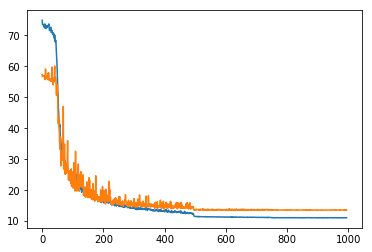

In [19]:
plt.plot(callback_list[1].history['train_loss'][5:])
plt.plot(callback_list[1].history['val_loss'][5:])

In [23]:
checkpoint = torch.load('../results/resnet/resnet-34-1c.pth-best.tar')

## Loading the best model

In [24]:
from cpe775.utils.img_utils import show_landmarks_batch

In [25]:
net = resnet34(in_shape=(-1, 1, 256, 256), out_shape=(-1, 68, 2))

In [26]:
best_model = Model(net)
best_net = model.net
best_net.load_state_dict(checkpoint['state_dict'])

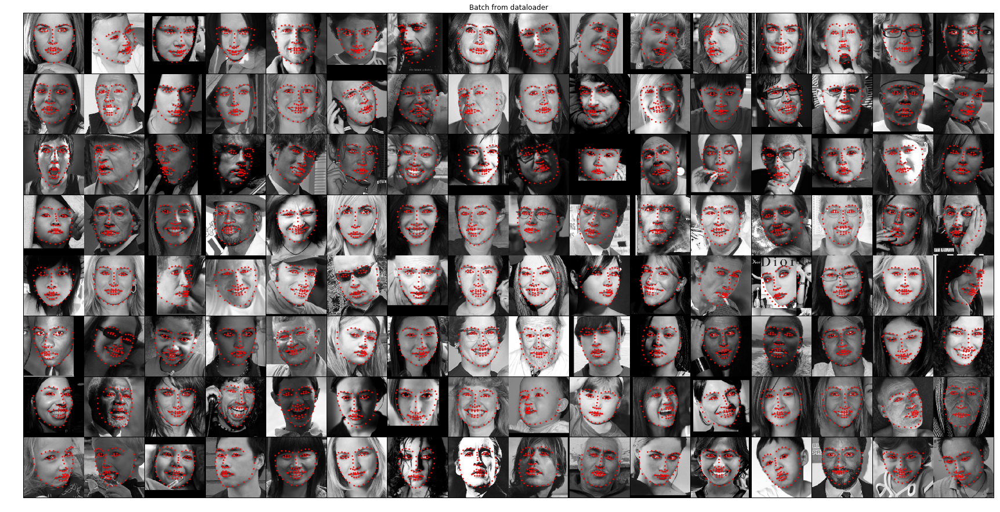

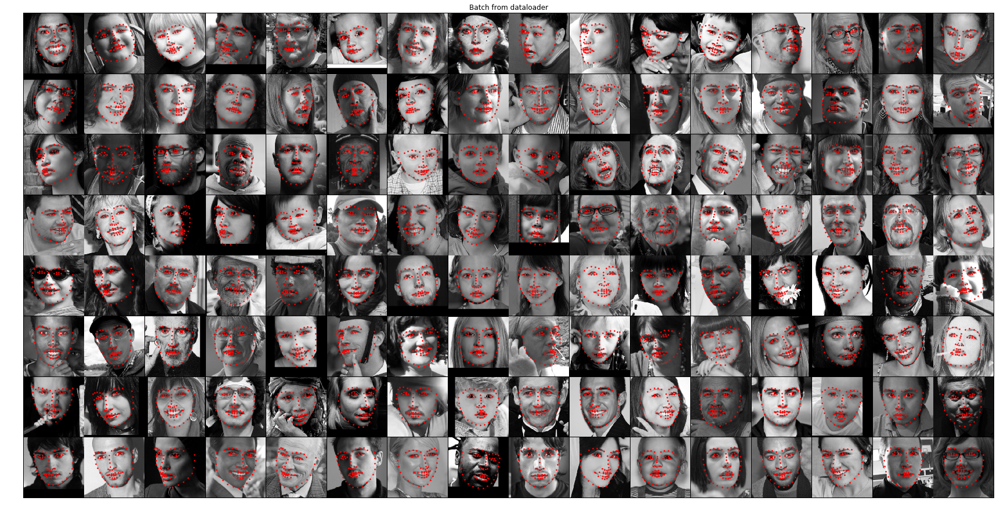

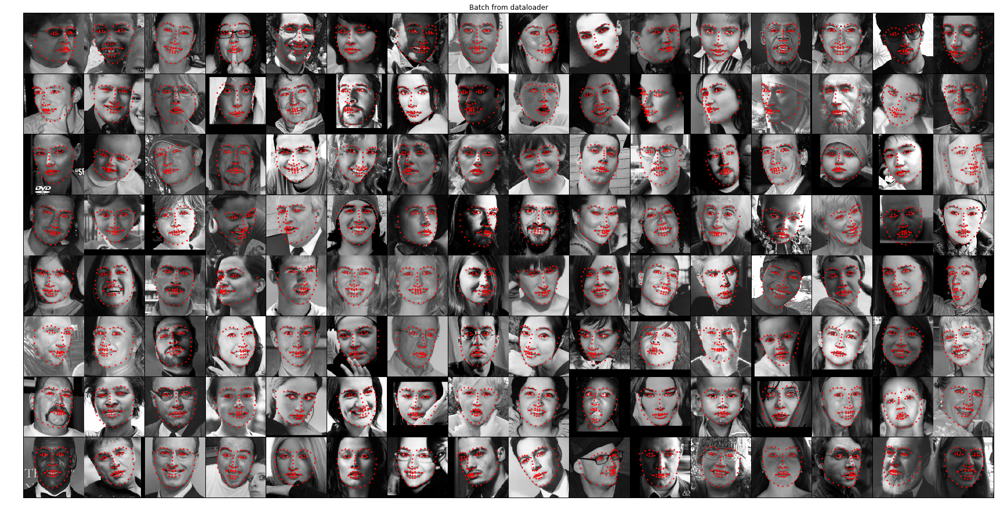

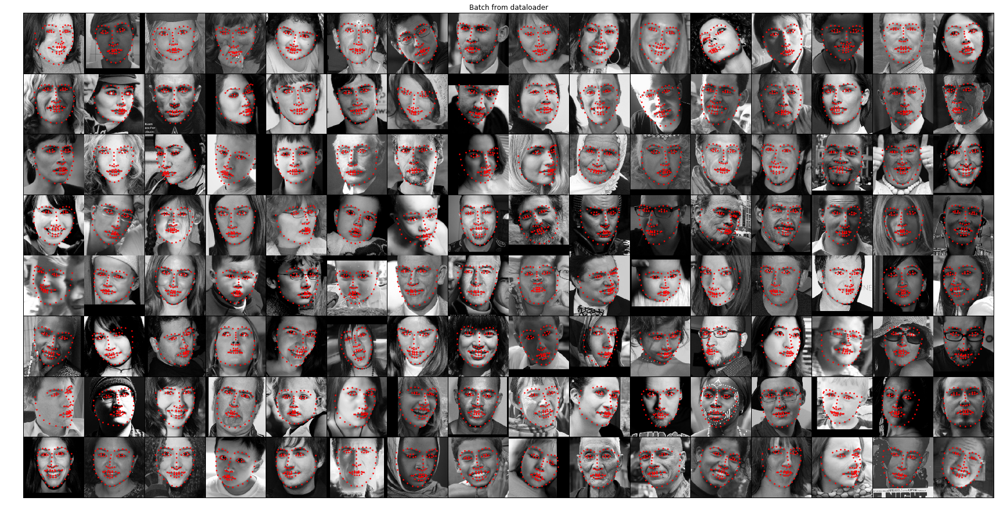

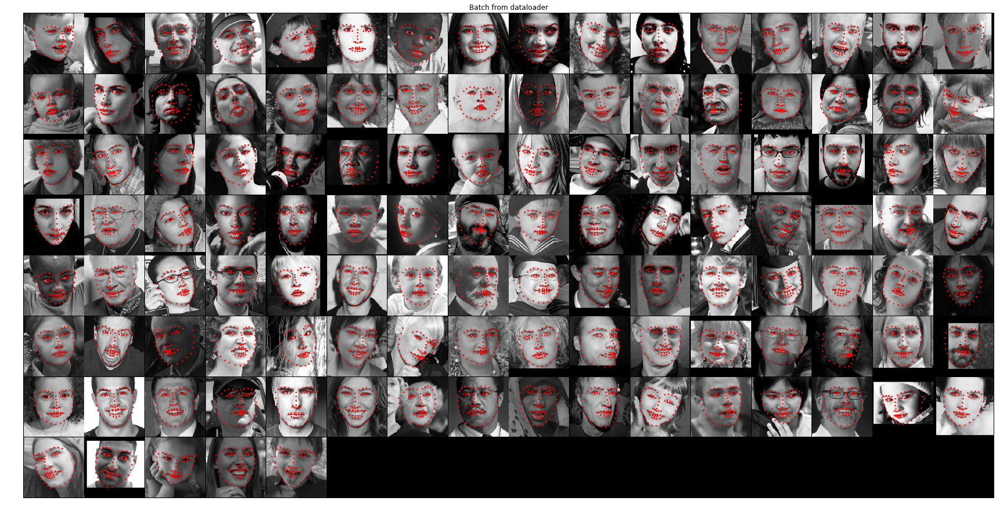

In [27]:
for i_batch, sample_batched in enumerate(valid_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data

    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)

    plt.axis('off')
    plt.ioff()
    plt.show()

### Common test

In [28]:
transforms = Compose([
                   CropFace(),
                   CenterCrop((224,224)),
                   ToGray(),
                   ToTensor()
                 ])

In [29]:
# load the dataset
dataset = FaceLandmarksDataset(csv_file='../data/common_test.csv',
                               root_dir='../data/',
                               transform=transforms)

common_loader = torch.utils.data.DataLoader(dataset, 
                batch_size=batch_size, num_workers=4)

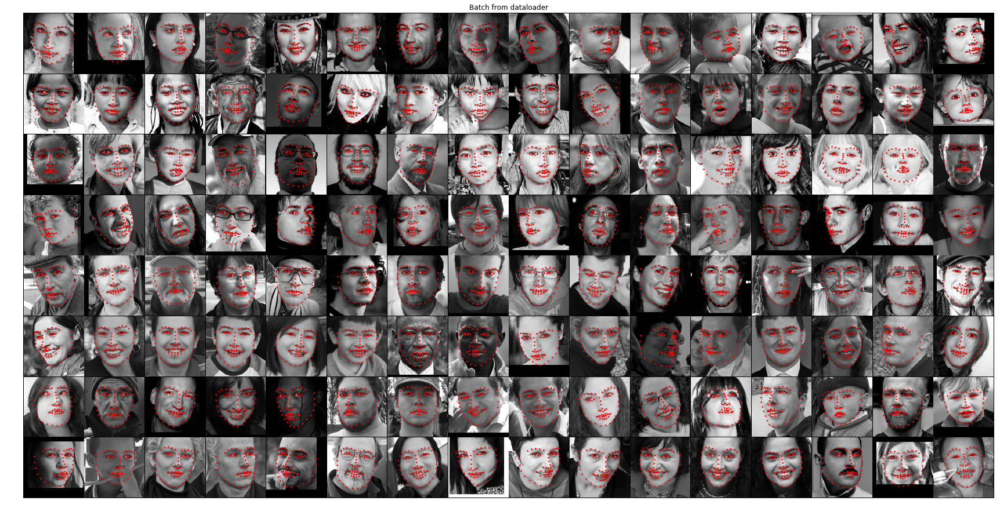

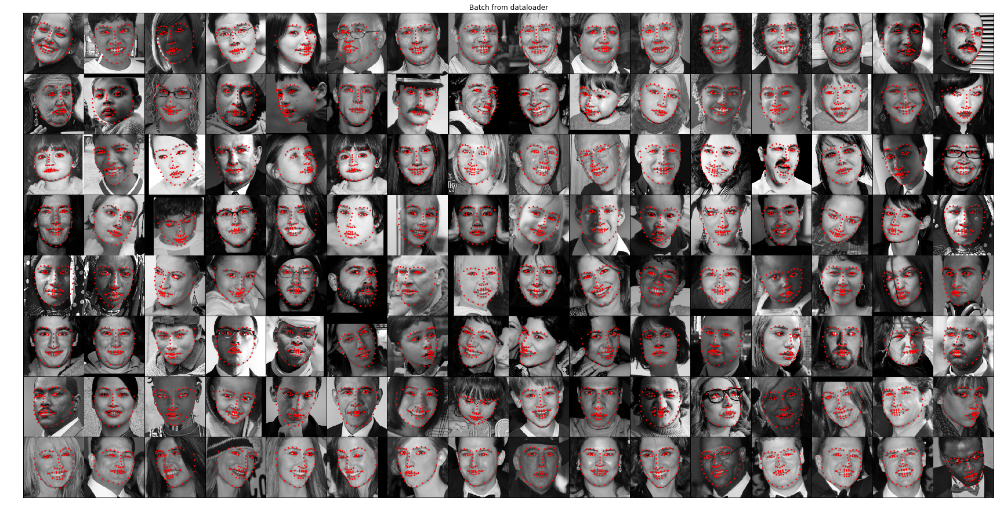

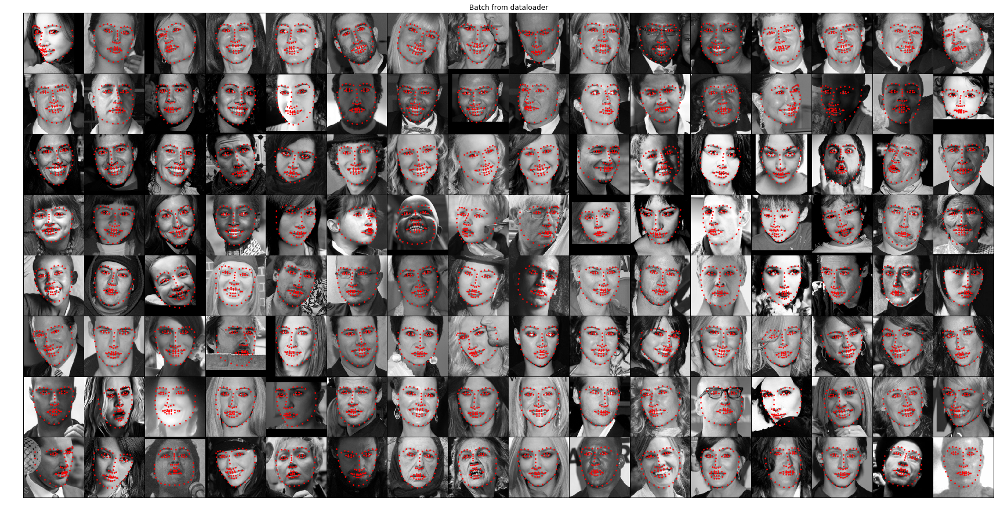

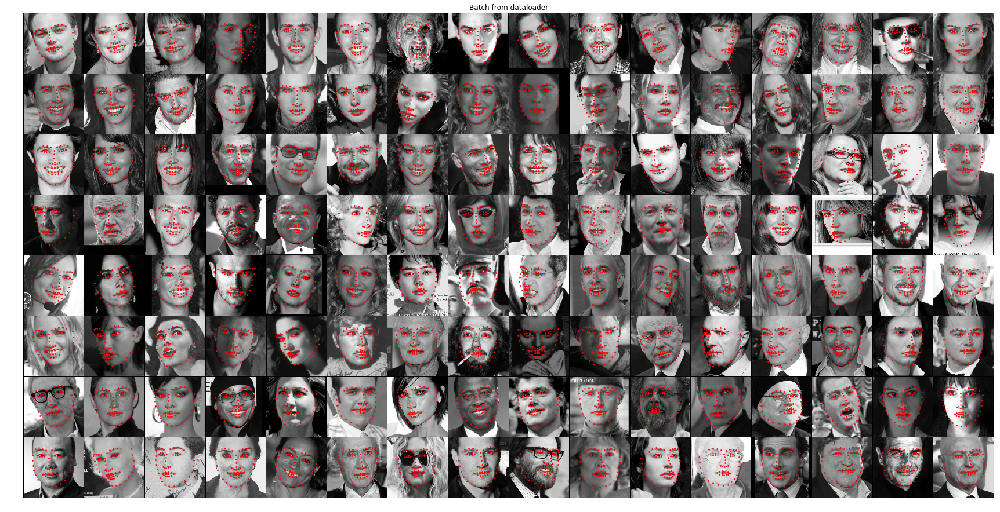

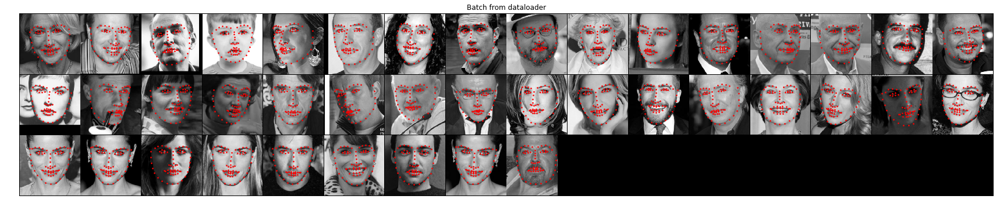

In [30]:
loss = 0
for i_batch, sample_batched in enumerate(common_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data
    
    loss += predicted_landmarks.shape[0]*criterion(predicted_landmarks, sample_batched['landmarks'])
    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)
    plt.axis('off')
    plt.ioff()
    plt.show()

In [31]:
loss/len(dataset)

12.687751535373398

### Challenging test

In [32]:
# load the dataset
challenging_set = FaceLandmarksDataset(csv_file='../data/challenging_test.csv',
                               root_dir='../data/',
                               transform=transforms)

challeging_loader = torch.utils.data.DataLoader(challenging_set, 
                batch_size=batch_size, num_workers=4)

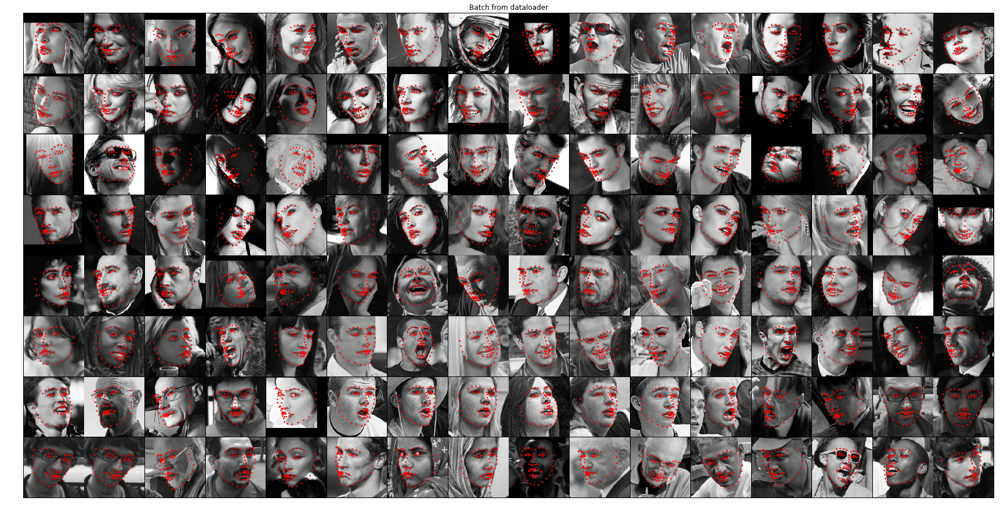

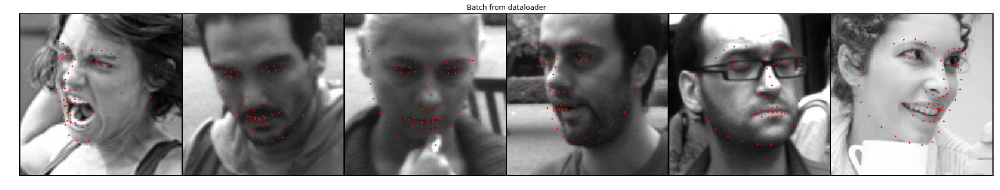

In [33]:
loss = 0
for i_batch, sample_batched in enumerate(challeging_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data
    
    loss += predicted_landmarks.shape[0]*criterion(predicted_landmarks, sample_batched['landmarks'])
    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)
    plt.axis('off')
    plt.ioff()
    plt.show()

In [34]:
loss/len(challenging_set)

27.353319078239043